## Laboratorium 7


## Detekcja obiektów za pomocą Faster-RCNN

### Wprowadzenie

Celem tej listy jest praktyczne zapoznanie się z działaniem dwuetapowych modeli do detekcji obiektów na przykładzie Faster R-CNN. Skorzystamy z gotowej implementacji modelu z pakietu [`torchvision`](https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py). Jeżeli masz inny ulubiony model działający na podobnej zasadzie, możesz z niego skorzystać zamiast podanego. Podobnie implementacja - jeśli masz swoją ulubioną bibliotekę np. Detectron2, MMDetection, możesz z niej skorzystać.

W zadaniu wykorzystany zostanie zbiór danych [_Chess Pieces Dataset_](https://public.roboflow.com/object-detection/chess-full) (autorstwa Roboflow, domena publiczna), ZIP z obrazami i anotacjami powinien być dołączony do instrukcji.

Podczas realizacji tej listy większy nacisk położony zostanie na inferencję z użyciem Faster R-CNN niż na uczenie (które przeprowadzisz raz\*). Kluczowe komponenty w tej architekturze (RPN i RoIHeads) można konfigurować bez ponownego uczenia, dlatego badania skupią się na ich strojeniu. Aby zrozumieć działanie modelu, konieczne będzie spojrzenie w jego głąb, włącznie z częściowym wykonaniem. W tym celu warto mieć na podorędziu kod źródłowy, w szczególności implementacje następujących klas (uwaga - linki do najnowszej implementacji; upewnij się więc, że czytasz kod używanej przez siebie wersji biblioteki):
* `FasterRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py
* `GeneralizedRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/generalized_rcnn.py
* `RegionProposalNetwork`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/rpn.py
* `RoIHeads`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/roi_heads.py

Dogłębne zrozumienie procedury uczenia modelu nie będzie wymagane, niemniej należy mieć ogólną świadomość jak ten proces przebiega i jakie funkcje kosztu są wykorzystywane. Użyjemy gotowej implementacji z submodułu [`references.detection`](https://github.com/pytorch/vision/blob/main/references/detection/train.py) w nieco uproszczonej wersji. Ponieważ ten moduł **nie** jest domyślnie instalowaną częścią pakietu `torchvision`, do instrukcji dołączono jego kod w nieznacznie zmodyfikowanej wersji (`references_detection.zip`).
Jeśli ciekawią Cię szczegóły procesu uczenia, zachęcam do lektury [artykułu](https://arxiv.org/abs/1506.01497) i analizy kodu implementacji.

In [1]:
import os

# Change the current working directory
current_dir = "/net/tscratch/people/plgkonkie311/apow7"  # Specify your desired directory
os.chdir(current_dir)

# Verify the change
print(os.getcwd())

/net/tscratch/people/plgkonkie311/apow7


In [2]:
# %pip install torch torchvision

In [3]:
# %pip install torchvision>=0.13 # jeśli nie posiadasz pakietu torchvision

In [4]:
# !pip install pycocotools

### Zadanie 0: Uczenie

Krokiem "zerowym" będzie przygotowanie wstępnie nauczonego modelu i douczenie go na docelowym zbiorze.
Podany zestaw hiperparametrów powinien dawać przyzwoite (niekoniecznie idealne) wyniki - jeśli chcesz, śmiało dobierz swoje własne; nie spędzaj na tym jednak zbyt wiele czasu.

Twoim zadaniem jest nie tylko przeklikanie poniższych komórek, ale przynajmniej ogólne zrozumienie procesu uczenia (przejrzyj implementację `train_one_epoch`) i struktury modelu.

In [5]:
import os
import time
import datetime

import torch
import torch.utils.data
import torchvision
import torchvision.models.detection as M
from torchvision.io.image import read_image
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image

from detection import coco_utils, presets, utils, transforms
from detection.engine import train_one_epoch, evaluate

In [6]:
def fake_segmentation(image, target):
    for obj in target["annotations"]:
        x, y, w, h = obj["bbox"]
        segm = [x, y, x + w, y, x + w, y + h, x, y + h]
        obj["segmentation"] = [segm]
    return image, target

In [7]:
def get_dataset(img_root: str, file_name: str, train: bool = True):
    """Reimplementacja analogicznej funkcji z pakietu references, rozwiązująca drobną niekompatybilność w zbiorze CPD"""

    tfs = transforms.Compose(
        [
            fake_segmentation,
            coco_utils.ConvertCocoPolysToMask(),
            (
                presets.DetectionPresetTrain(data_augmentation="hflip")
                if train
                else presets.DetectionPresetEval()
            ),
            # jeśli chcesz dodać swoje własne augmentacje, możesz zrobić to tutaj
        ]
    )
    ds = coco_utils.CocoDetection(img_root, file_name, transforms=tfs)
    return ds

In [8]:
# Konfiguracja hiperparametrów
LR = 0.001 # powinno być dobrze dla 1 GPU
WDECAY = 0.0001
EPOCHS = 100
VAL_FREQ = 5 # walidacja i checkpointowanie co N epok
BATCH_SIZE = 32 # dobierz pod możliwości sprzętowe
NUM_WORKERS = 4 # j/w
NUM_CLASSES = 14
DEVICE = 'cuda:0'
DATASET_ROOT = 'dane/'
OUTPUT_DIR = 'outputs/'

In [9]:
# Zaczytanie datasetów
chess_train = get_dataset(os.path.join(DATASET_ROOT, 'train'), os.path.join(DATASET_ROOT, 'train/_annotations.coco.json'))
chess_val = get_dataset(os.path.join(DATASET_ROOT, 'valid'), os.path.join(DATASET_ROOT, 'valid/_annotations.coco.json'))

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [10]:
# samplery i loadery
train_sampler = torch.utils.data.RandomSampler(chess_train)
train_batch_sampler = torch.utils.data.BatchSampler(train_sampler, BATCH_SIZE, drop_last=True)
train_loader = torch.utils.data.DataLoader(
  chess_train, batch_sampler=train_batch_sampler, num_workers=NUM_WORKERS, collate_fn=utils.collate_fn
)

val_sampler = torch.utils.data.SequentialSampler(chess_val)
val_loader = torch.utils.data.DataLoader(
  chess_val, batch_size=1, sampler=val_sampler, num_workers=NUM_WORKERS, collate_fn=utils.collate_fn
)

In [11]:
# Skonstruowanie modelu; tworzymy w wersji dla 91 klas aby zainicjować wagi wstępnie nauczone na COCO...
model = M.fasterrcnn_resnet50_fpn(weights=M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1, num_classes=91).to(DEVICE)
# ...po czym zastępujemy predyktor mniejszym, dostosowanym do naszego zbioru:
model.roi_heads.box_predictor = M.faster_rcnn.FastRCNNPredictor(in_channels=1024, num_classes=NUM_CLASSES).to(DEVICE)

In [12]:
model # zwróć uwagę na strukturę Box Predictora (dlaczego tyle out_features?)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

#UCZENIE - POMIŃ JEŻELI JUŻ UCZYŁEŚ

In [13]:
# # Zanim przejdziemy do uczenia pełnego modelu, wykonamy krótkie wstępne uczenie losowo zainicjowanego predyktora:
# train_one_epoch(
#   model=model,
#   optimizer=torch.optim.AdamW(model.roi_heads.box_predictor.parameters(), lr=LR, weight_decay=WDECAY),
#   data_loader=train_loader,
#   device=DEVICE,
#   epoch=0, print_freq=20, scaler=None
# )

In [14]:
# # Uczenie pełnego modelu
# optimizer = torch.optim.AdamW(
#   [p for p in model.parameters() if p.requires_grad],
#   lr=LR,
#   weight_decay=WDECAY
# )
# lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[10], gamma=0.1) # dobierz wartości jeśli trzeba


In [15]:

# start_time = time.time()
# for epoch in range(EPOCHS):
#     train_one_epoch(model, optimizer, train_loader, DEVICE, epoch, 20, None)
#     lr_scheduler.step()

#     # eval and checkpoint every VAL_FREQ epochs
#     if (epoch+1) % VAL_FREQ == 0:
#       checkpoint = {
#           "model": model.state_dict(),
#           "optimizer": optimizer.state_dict(),
#           "lr_scheduler": lr_scheduler.state_dict(),
#           "epoch": epoch,
#       }
#       utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, f"model_{epoch}.pth"))
#       utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, "checkpoint.pth"))
#       evaluate(model, val_loader, device=DEVICE)

# total_time = time.time() - start_time
# total_time_str = str(datetime.timedelta(seconds=int(total_time)))
# print(f"Training time {total_time_str}")

# Wczytanie modelu

In [ ]:
optimizer = torch.optim.AdamW(
  [p for p in model.parameters() if p.requires_grad],
  lr=LR,
  weight_decay=WDECAY
)
lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[10], gamma=0.1)


checkpoint = torch.load(os.path.join(OUTPUT_DIR, "checkpoint.pth"), map_location=DEVICE)
model.load_state_dict(checkpoint["model"])
optimizer.load_state_dict(checkpoint["optimizer"])
lr_scheduler.load_state_dict(checkpoint["lr_scheduler"])
start_epoch = checkpoint["epoch"] + 1

print(f"Checkpoint loaded, starting from epoch {start_epoch}")

/net/tscratch/people/plgkonkie311/slurm_jobdir/1152286/tmp.t0041/ipykernel_2185168/3241209476.py:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(os.

Checkpoint loaded, starting from epoch 100


In [17]:
DEVICE = 'cuda'
model = model.to(DEVICE)
next(model.parameters()).device

device(type='cuda', index=0)

In [18]:
import matplotlib.pyplot as plt

In [19]:
# Inferencja na zadanym obrazie
preprocess = M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1.transforms() # to wystarczy pobrać raz
img = read_image(os.path.join(DATASET_ROOT, 'test/IMG_0159_JPG.rf.1cf4f243b5072d63e492711720df35f7.jpg'))
batch = [preprocess(img).to(DEVICE)]

# Set the model to evaluation mode
model.eval()

# Perform inference
with torch.no_grad():
  prediction = model(batch)[0]

# Rysowanie predykcji - wygodny gotowiec
box = draw_bounding_boxes(
  img,
  boxes=prediction['boxes'],
  labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
  colors='red',
  width=4,
)



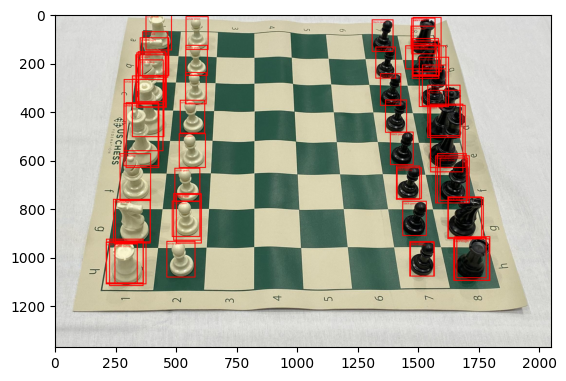

In [20]:

plt.imshow(to_pil_image(box.detach()))
# to_pil_image(box.detach()).show()

---
### Zadanie 1

Zbadaj wpływ parametrów inferencji **głowic `RoIHeads`**, progu prawdopodobieństwa (`score_thresh`) i progu NMS (`nms_thresh`), na działanie modelu. Wykorzystaj funkcję `evaluate` aby zmierzyć zmianę jakości predykcji, ale przebadaj też efekty wizualnie, wyświetlając predykcje dla kilku obrazów ze zbioru walidacyjnego i kilku spoza zbioru (folder `wild`). _W finalnej wersji pozostaw tylko wybrane interesujące przykłady._

In [21]:
file_names = [
    'valid/c1f800417bc42263d141b5ed785e7707_jpg.rf.337b6ba78718cfc7228c7484c4a361f3.jpg',
    'valid/15cc23c777b00d0e123f9df468f2852b_jpg.rf.a3f074f0d6beb76eb98cc6fa73ddce77.jpg',
    'valid/d6e283a49b0395a6d5867c9e98e32045_jpg.rf.2571cdc4c5d218d1f8ecd4becc57c5ce.jpg',
    'valid/3baf85c957b9d28a16c0b65cb2ef0d29_jpg.rf.ee68e051c8a61b8784b87686d828cf59.jpg',
    'valid/73e6a751c50604d017541c11b28d8417_jpg.rf.81ee4214a166fd5de37da0bbfc5ef06c.jpg',
    'chesscom_fide.jpeg',
    'chesscom_uscf.jpeg',
    'shop.jpg'
]

img_paths = [ os.path.join(DATASET_ROOT, f) for f in file_names ]


In [22]:
def visulize_predictions(model, img_paths=img_paths, device='cuda', title='Predictions'):
    model.eval()
    
    fig, axs = plt.subplots(4, 2, figsize=(10, 15))
    axs = axs.ravel()

    for i, img_path in enumerate(img_paths):
        img = read_image(img_path)
        batch = [preprocess(img).to(device)]

        with torch.no_grad():
            prediction = model(batch)[0]

        box = draw_bounding_boxes(
            img,
            boxes=prediction['boxes'],
            labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
            colors='red',
            width=4,
        )

        axs[i].imshow(to_pil_image(box.detach()))
        axs[i].axis('off')
        axs[i].set_title(f'Image {i+1} - Boxes: {len(prediction["boxes"])}')

    fig.suptitle(title)

    plt.tight_layout()

Test:  [ 0/58]  eta: 0:00:16  model_time: 0.0250 (0.0250)  evaluator_time: 0.0040 (0.0040)  time: 0.2844  data: 0.2511  max mem: 1160
Test:  [57/58]  eta: 0:00:00  model_time: 0.0202 (0.0208)  evaluator_time: 0.0012 (0.0023)  time: 0.0334  data: 0.0053  max mem: 1160
Test: Total time: 0:00:02 (0.0405 s / it)
Averaged stats: model_time: 0.0202 (0.0208)  evaluator_time: 0.0012 (0.0023)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.238
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.296
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.238
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

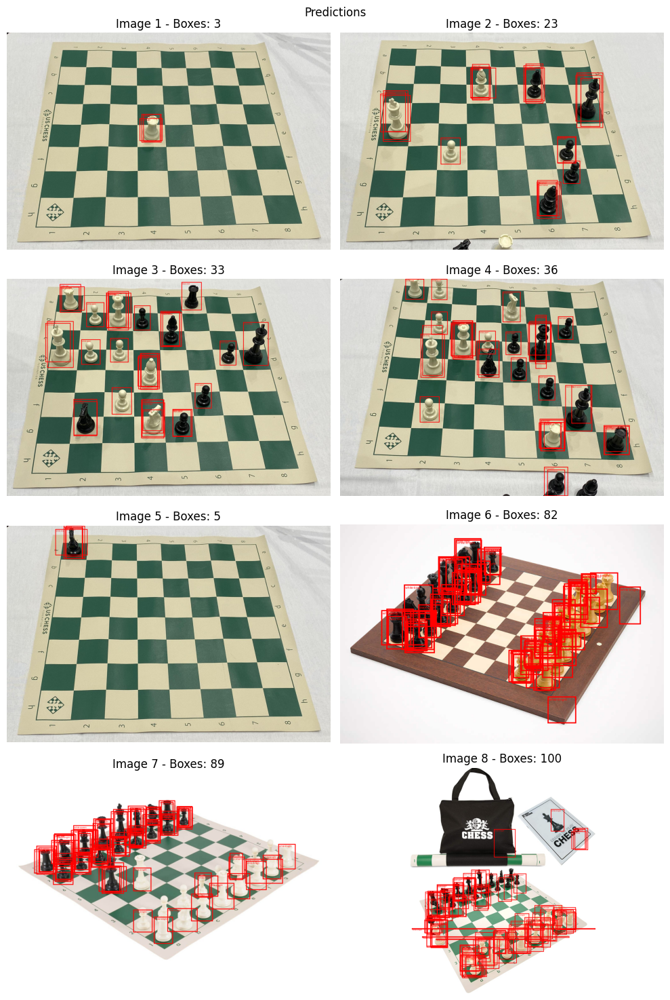

In [23]:
evaluate(model, val_loader, device=DEVICE)
visulize_predictions(model, img_paths=img_paths, device=DEVICE)

In [24]:
def visulize_predictions_param(model, img_paths=img_paths, device='cuda', title='Predictions', params=None):
    model.eval()
    
    fig, axs = plt.subplots(len(params), len(img_paths), figsize=(10, 15))

    for i, param in enumerate(params):
        for j, img_path in enumerate(img_paths):

            model.roi_heads.score_thresh = param

            img = read_image(img_path)
            batch = [preprocess(img).to(device)]

            with torch.no_grad():
                prediction = model(batch)[0]

            box = draw_bounding_boxes(
                img,
                boxes=prediction['boxes'],
                labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
                colors='red',
                width=4,
            )

            axs[i, j].imshow(to_pil_image(box.detach()))
            axs[i, j].axis('off')
            axs[i, j].set_title(f'score_thresh {param} - Boxes: {len(prediction["boxes"])}')

In [25]:
print(f'Score thresh: {model.roi_heads.score_thresh}')
print(f'NMS thresh: {model.roi_heads.nms_thresh}')

Score thresh: 0.05
NMS thresh: 0.5


`score_thresh` - parametr określający próg prawdopodobieństwa, poniżej którego predykcje będą odrzucane. Wartość domyślna to 0.05.

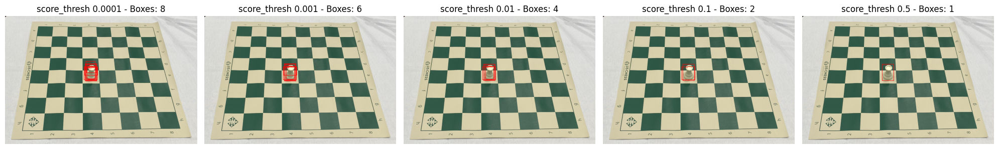

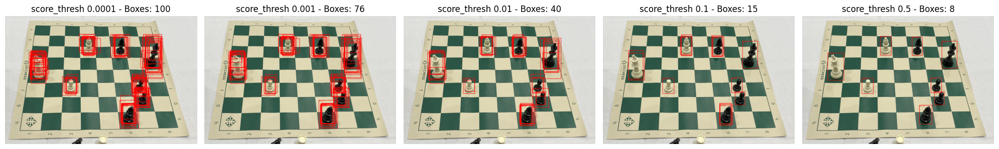

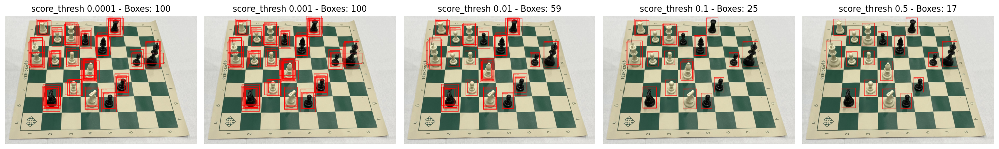

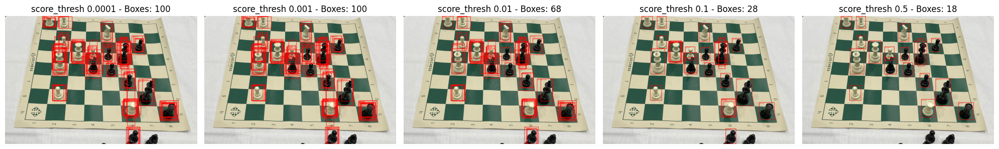

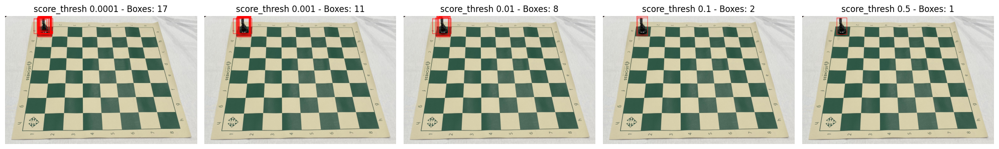

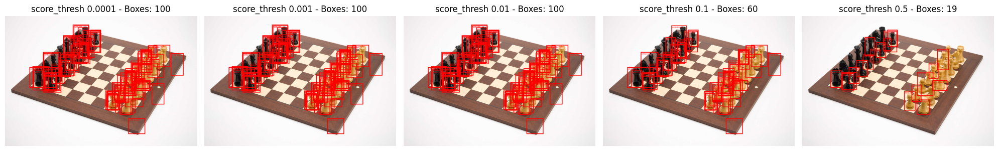

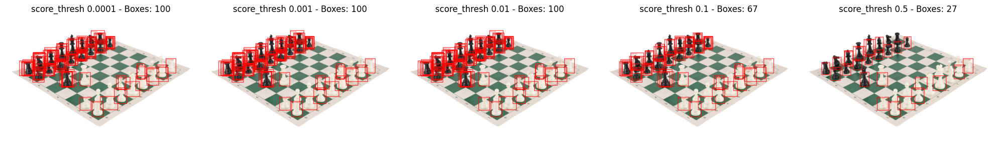

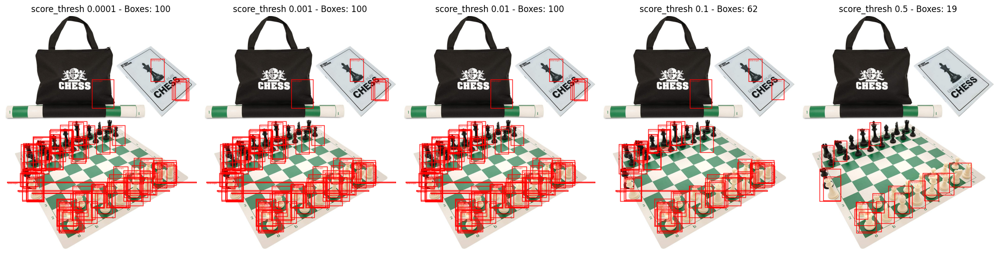

In [26]:
score_thresholds = [0.0001, 0.001, 0.01, 0.1, 0.5]

model.eval()


for _, img_path in enumerate(img_paths):
    fig, axs = plt.subplots(1, len(score_thresholds), figsize=(20, 30))

    for j, param in enumerate(score_thresholds):

        model.roi_heads.score_thresh = param

        img = read_image(img_path)
        batch = [preprocess(img).to('cuda')]

        with torch.no_grad():
            prediction = model(batch)[0]

        box = draw_bounding_boxes(
            img,
            boxes=prediction['boxes'],
            labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
            colors='red',
            width=4,
        )

        axs[j].imshow(to_pil_image(box.detach()))
        axs[j].axis('off')
        axs[j].set_title(f'score_thresh {param} - Boxes: {len(prediction["boxes"])}')
    plt.tight_layout()
    plt.show()

In [27]:
for score_thresh in score_thresholds:
    model.roi_heads.score_thresh = score_thresh
    print('#'*50)
    print(f'Score thresh: {model.roi_heads.score_thresh}')
    evaluate(model, val_loader, device=DEVICE)

##################################################
Score thresh: 0.0001
Test:  [ 0/58]  eta: 0:00:17  model_time: 0.0260 (0.0260)  evaluator_time: 0.0063 (0.0063)  time: 0.2943  data: 0.2578  max mem: 1160
Test:  [57/58]  eta: 0:00:00  model_time: 0.0203 (0.0211)  evaluator_time: 0.0022 (0.0036)  time: 0.0347  data: 0.0053  max mem: 1160
Test: Total time: 0:00:02 (0.0422 s / it)
Averaged stats: model_time: 0.0203 (0.0211)  evaluator_time: 0.0022 (0.0036)
Accumulating evaluation results...
DONE (t=0.07s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.237
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.289
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ]

`nms_thresh` - parametr określający próg IoU, powyżej którego nachodzące się bounding boxy będą odrzucane. Wybierany jest bounding box z najwyższym score, a inne nakładające się boxy są odrzucane, jeśli ich IoU przekracza próg NMS. Wartość domyślna to 0.5.



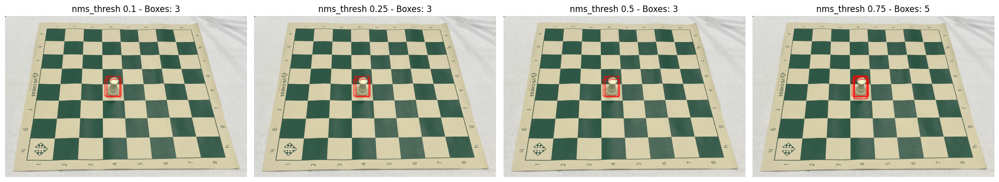

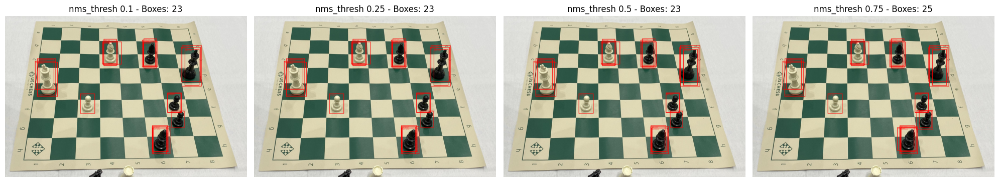

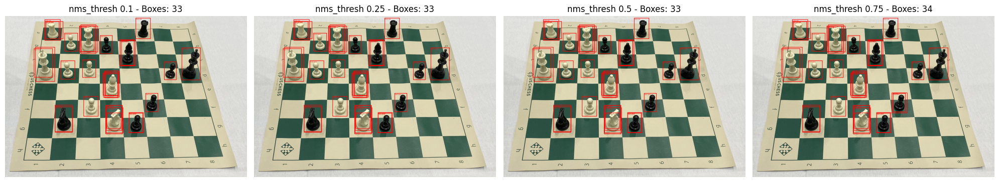

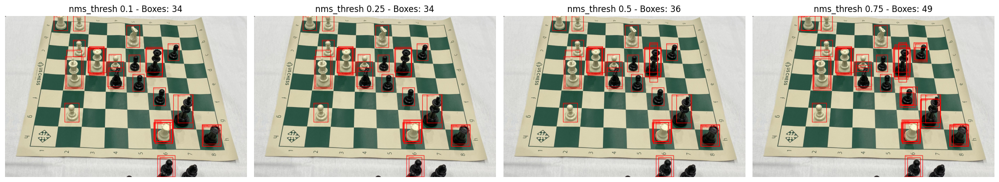

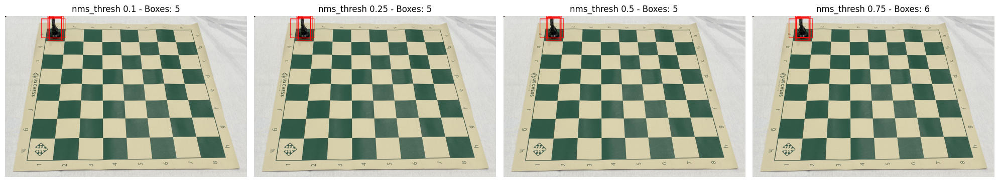

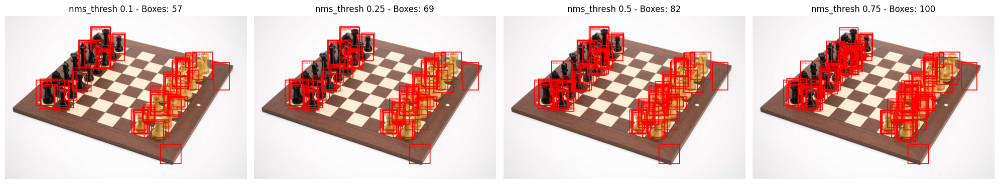

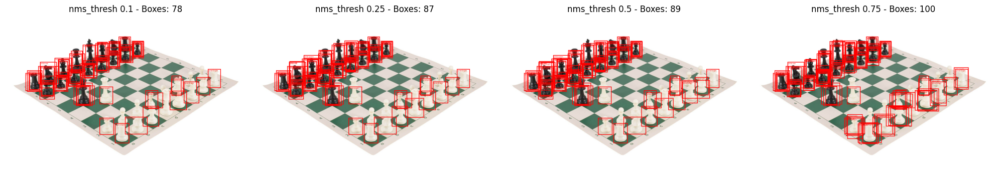

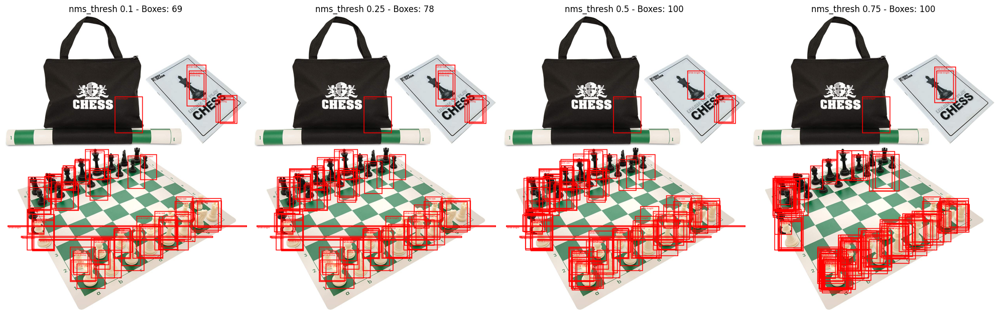

In [28]:
score_thresh = 0.05
nms_thresholds = [0.1, 0.25, 0.5, 0.75]

model.eval()

for _, img_path in enumerate(img_paths):
    fig, axs = plt.subplots(1, len(nms_thresholds), figsize=(20, 20))

    for j, param in enumerate(nms_thresholds):

        model.roi_heads.nms_thresh = param
        model.roi_heads.score_thresh = score_thresh

        img = read_image(img_path)
        batch = [preprocess(img).to('cuda')]

        with torch.no_grad():
            prediction = model(batch)[0]

        box = draw_bounding_boxes(
            img,
            boxes=prediction['boxes'],
            labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
            colors='red',
            width=4,
        )

        axs[j].imshow(to_pil_image(box.detach()))
        axs[j].axis('off')
        axs[j].set_title(f'nms_thresh {param} - Boxes: {len(prediction["boxes"])}')
    plt.tight_layout()
    plt.show()

In [29]:
for nms_thresh in nms_thresholds:
    model.roi_heads.score_thresh = score_thresh
    model.roi_heads.nms_thresh = nms_thresh
    print('#'*50)
    print(f'Score thresh: {model.roi_heads.score_thresh}')
    print(f'NMS thresh: {model.roi_heads.nms_thresh}')
    evaluate(model, val_loader, device=DEVICE)

##################################################
Score thresh: 0.05
NMS thresh: 0.1
Test:  [ 0/58]  eta: 0:00:17  model_time: 0.0259 (0.0259)  evaluator_time: 0.0041 (0.0041)  time: 0.3014  data: 0.2672  max mem: 1160
Test:  [57/58]  eta: 0:00:00  model_time: 0.0203 (0.0209)  evaluator_time: 0.0011 (0.0023)  time: 0.0331  data: 0.0050  max mem: 1160
Test: Total time: 0:00:02 (0.0409 s / it)
Averaged stats: model_time: 0.0203 (0.0209)  evaluator_time: 0.0011 (0.0023)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.441
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.602
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.550
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large |

### Zadanie 2a

Zwizualizuj propozycje rejonów wygenerowane przez RPN i porównaj z ostateczną predykcją.

W tym celu konieczne będzie manualne wykonanie fragmentu metody `GeneralizedRCNN::forward` (patrz: [kod](https://github.com/pytorch/vision/blob/6279faa88a3fe7de49bf58284d31e3941b768522/torchvision/models/detection/generalized_rcnn.py#L46), link do wersji najnowszej na grudzień 2024).
Wszystkie fragmenty związane z uczeniem możesz rzecz jasna pominąć; chodzi o wyciągnięcie obiektu `proposals`.
Nie zapomnij o wykonaniu powrotnej transformacji! (Po co?)

In [53]:
model.roi_heads.score_thresh = 0.05
model.roi_heads.nms_thresh = 0.5

In [88]:
from collections import OrderedDict
from torchvision import transforms as T

def extract_proposals_and_predictions(model, images, device):
    model.eval()
    original_image_sizes = [img.shape[-2:] for img in images]
    images, _ = model.transform(images)

    features = model.backbone(images.tensors)
    if isinstance(features, torch.Tensor):
        features = OrderedDict([("0", features)])

    proposals, _ = model.rpn(images, features, None)
    detections, _ = model.roi_heads(features, proposals, images.image_sizes, None)
    detections = model.transform.postprocess(detections, images.image_sizes, original_image_sizes)

    proposals = [{'boxes': proposals[0],}]
    proposals = model.transform.postprocess(proposals, images.image_sizes, original_image_sizes)

    return proposals, detections

def visualize_proposals_and_predictions(images, proposals, detections, dataset, title='Proposals and Predictions'):
    for img, proposal, detection in zip(images, proposals, detections):

        num_proposals = len(proposal)
        num_all_detections = len(detection['boxes'])

        proposal_img = draw_bounding_boxes(img.cpu(), boxes=proposal['boxes'], colors='cyan', width=1)
        # Detections visualization
        detection_boxes = detection['boxes']
        detection_labels = [dataset.coco.cats[i.item()]['name'] for i in detection['labels']]

        detection_img = draw_bounding_boxes(proposal_img, boxes=detection_boxes, labels=detection_labels, colors='red', width=2)

        plt.figure(figsize=(12, 12))
        plt.imshow(to_pil_image(detection_img))
        plt.axis('off')
        plt.title(f"{title}: Proposals: {num_proposals}, Detections : {num_all_detections}")
        plt.show()

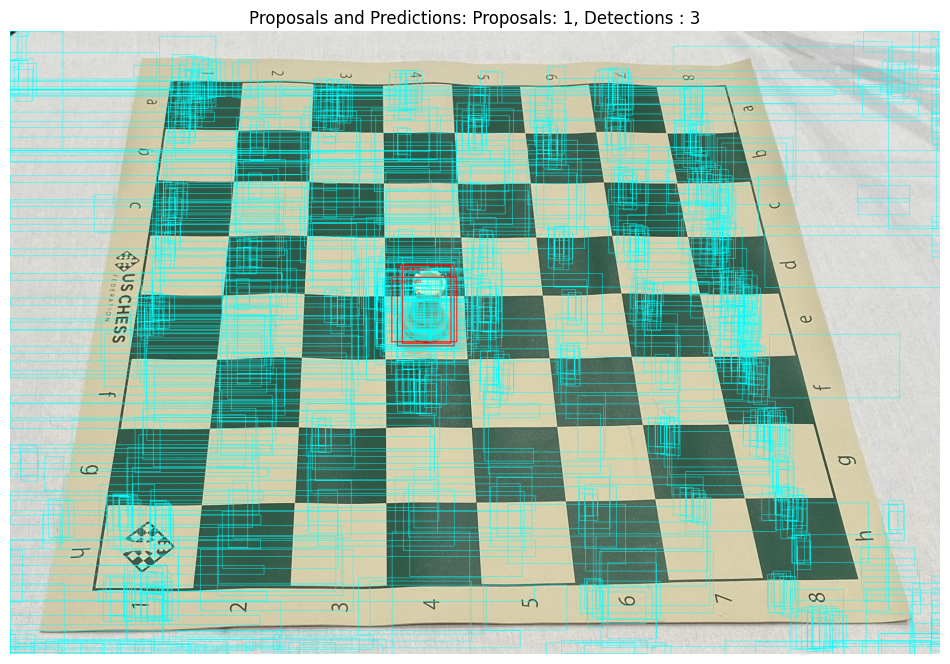

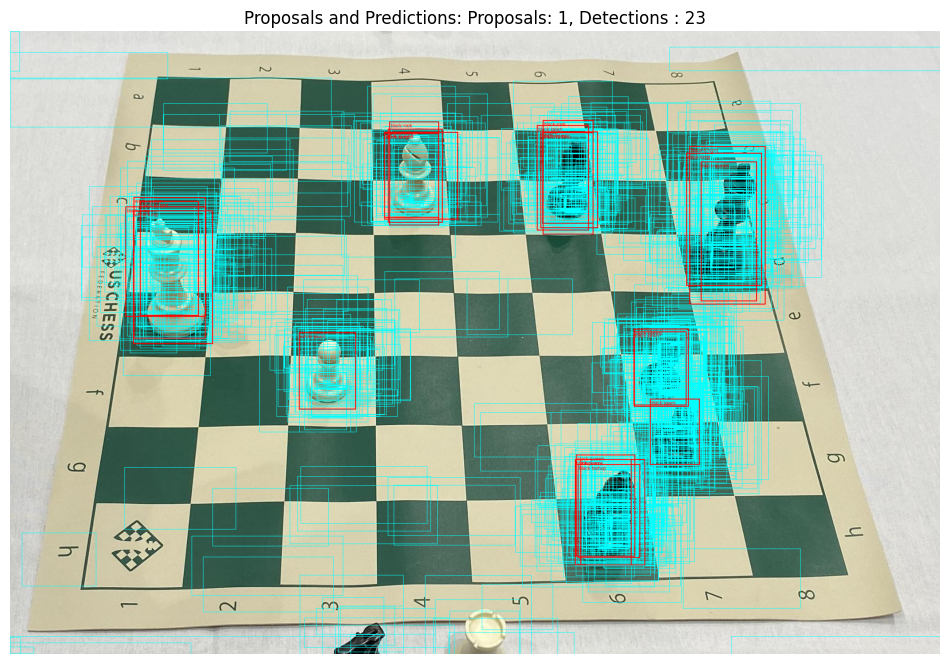

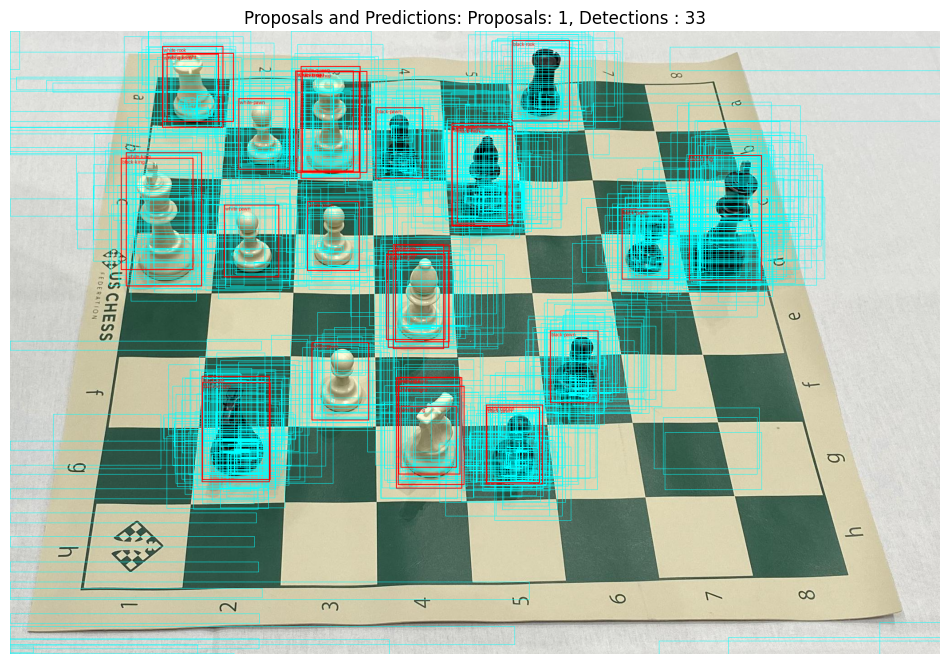

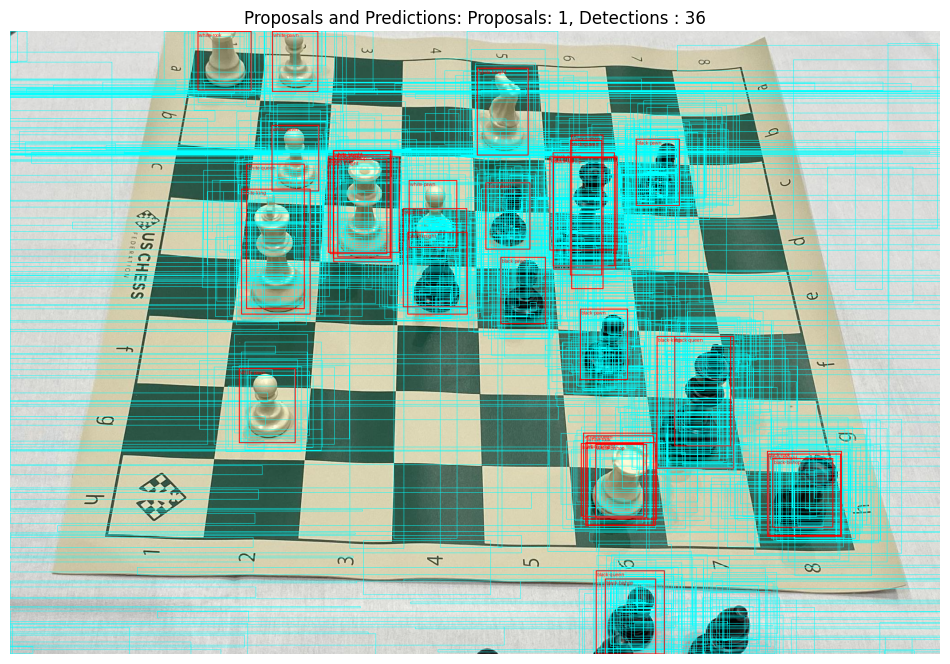

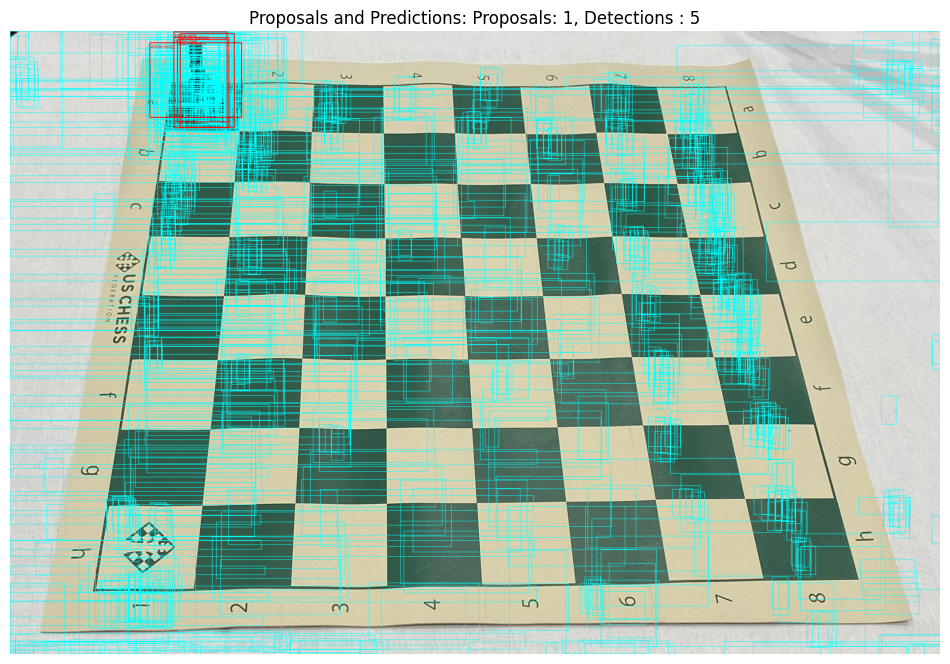

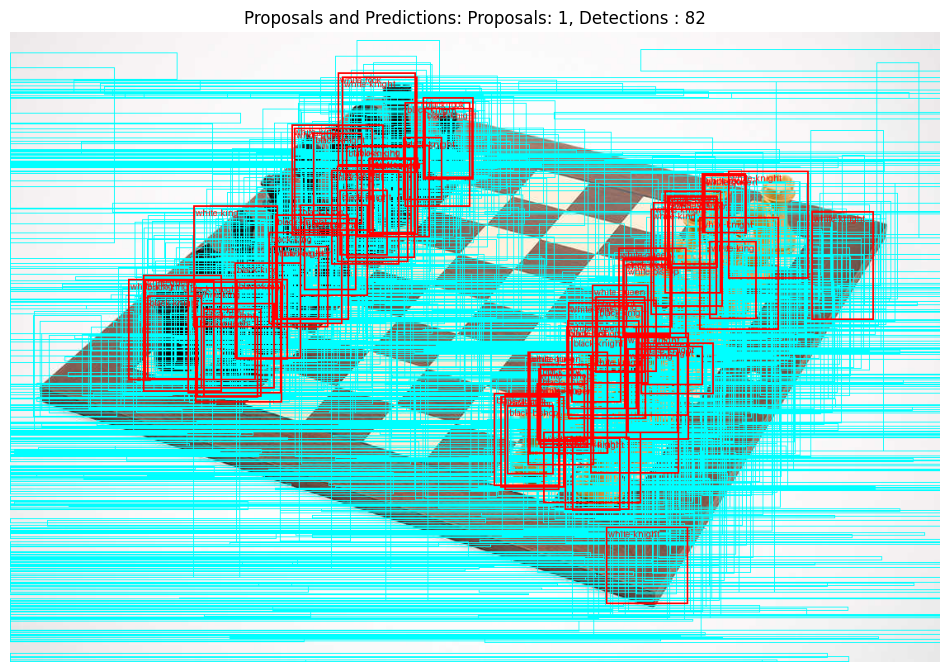

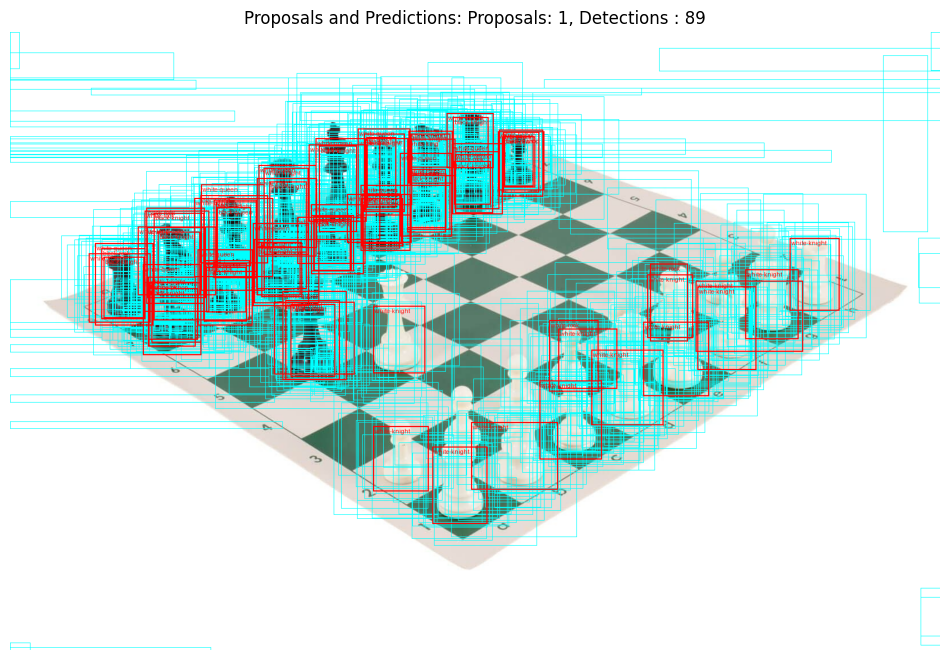

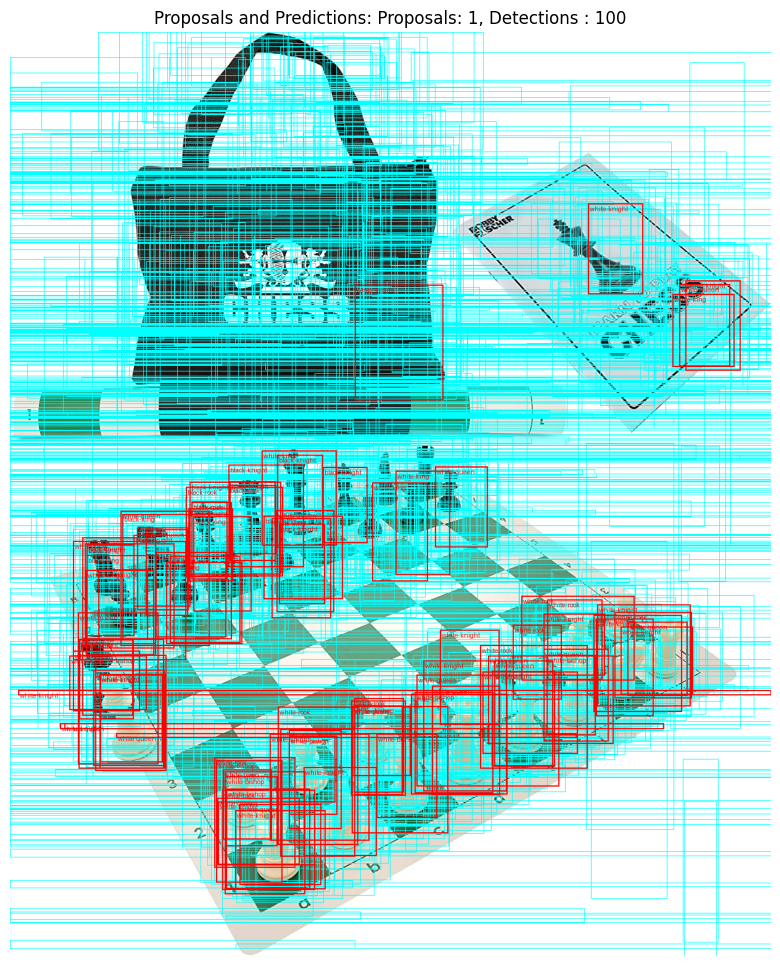

In [89]:
for img_path in img_paths:
    img = read_image(img_path)
    batch = [preprocess(img).to(DEVICE)]
    model.eval()

    with torch.no_grad():
        proposals, predictions = extract_proposals_and_predictions(model, batch, DEVICE)
        visualize_proposals_and_predictions(batch, proposals, predictions, chess_val)

### Zadanie 2b

Zbadaj wpływ progu NMS _na etapie propozycji_ na jakość predykcji oraz czas ich uzyskania.
Jak w poprzednich zadaniach, postaraj się nie ograniczyć tylko do pokazania metryk, ale pokaż wizualizacje (propozycji i predykcji) dla **wybranych** przykładów.

In [90]:
model.rpn.nms_thresh

0.7

In [91]:
import time

def evaluate_with_rpn_nms_threshold(model, val_loader, device, nms_thresh):
    # Modify RPN NMS threshold
    model.rpn.nms_thresh = nms_thresh

    # Evaluate and measure time
    start_time = time.time()
    evaluate(model, val_loader, device=device)
    end_time = time.time()
    inference_time = end_time - start_time

    return inference_time


Inference time for visualization: 0.02 seconds


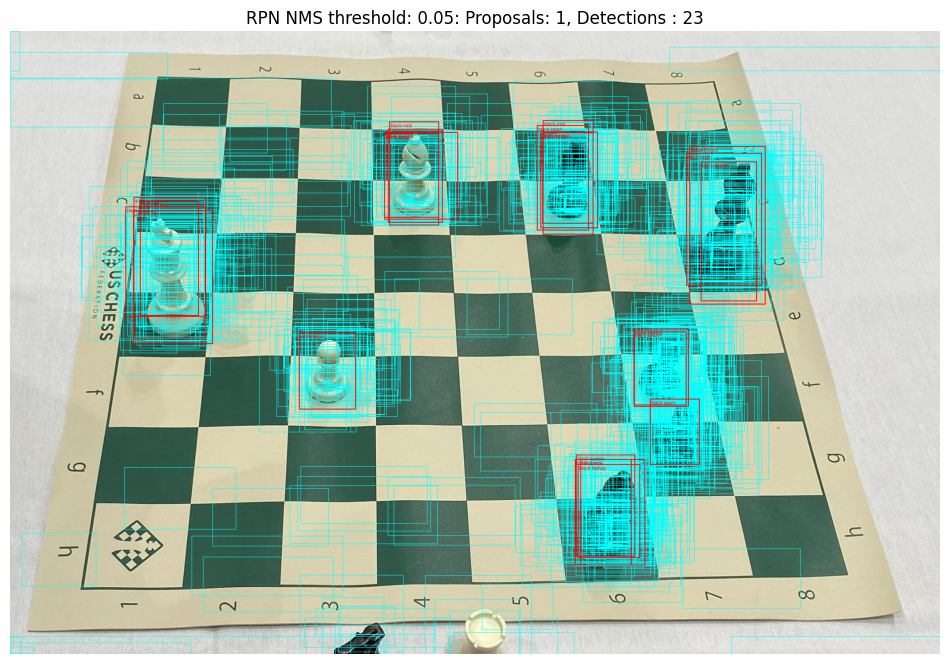

Evaluating with RPN NMS threshold: 0.05
Test:  [ 0/58]  eta: 0:00:17  model_time: 0.0243 (0.0243)  evaluator_time: 0.0040 (0.0040)  time: 0.3101  data: 0.2776  max mem: 1610
Test:  [57/58]  eta: 0:00:00  model_time: 0.0196 (0.0200)  evaluator_time: 0.0010 (0.0020)  time: 0.0331  data: 0.0063  max mem: 1610
Test: Total time: 0:00:02 (0.0410 s / it)
Averaged stats: model_time: 0.0196 (0.0200)  evaluator_time: 0.0010 (0.0020)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.378
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.354
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.295
 Average Recall     (AR

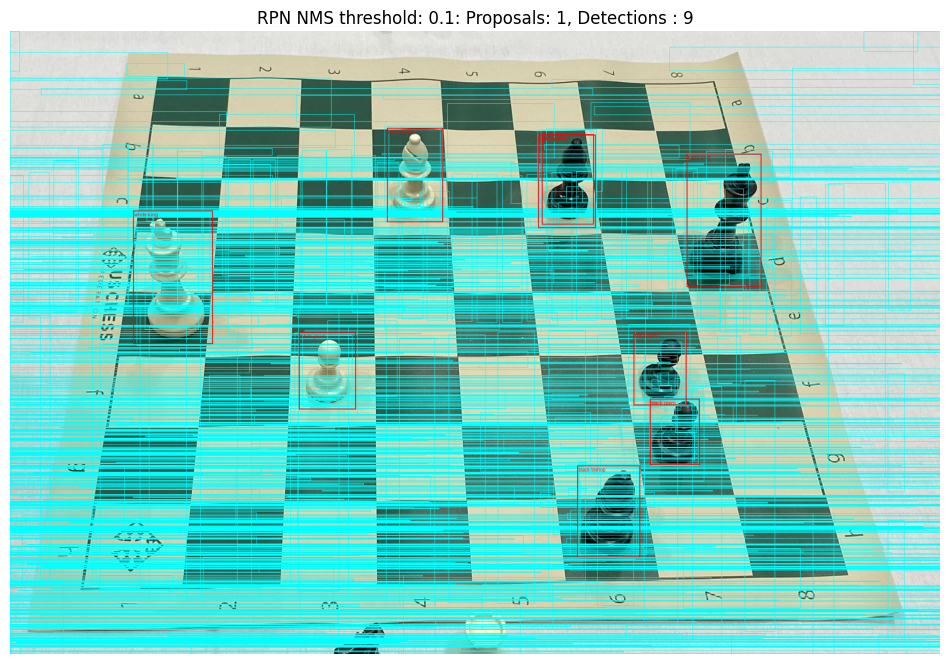

Evaluating with RPN NMS threshold: 0.1
Test:  [ 0/58]  eta: 0:00:18  model_time: 0.0231 (0.0231)  evaluator_time: 0.0034 (0.0034)  time: 0.3210  data: 0.2902  max mem: 1610
Test:  [57/58]  eta: 0:00:00  model_time: 0.0200 (0.0201)  evaluator_time: 0.0010 (0.0020)  time: 0.0333  data: 0.0060  max mem: 1610
Test: Total time: 0:00:02 (0.0413 s / it)
Averaged stats: model_time: 0.0200 (0.0201)  evaluator_time: 0.0010 (0.0020)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.179
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.243
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.222
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.179
 Average Recall     (AR)

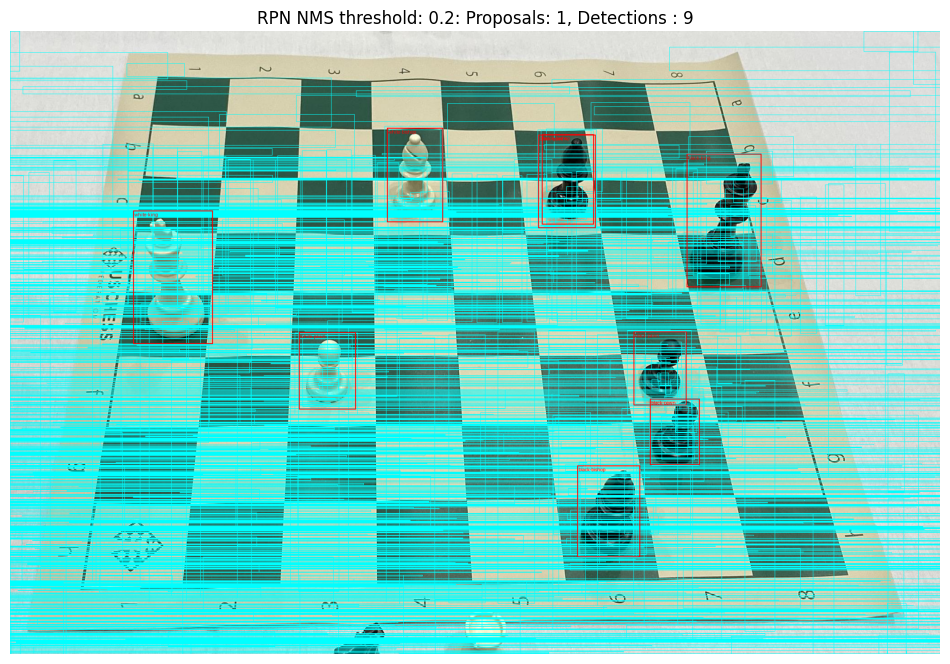

Evaluating with RPN NMS threshold: 0.2
Test:  [ 0/58]  eta: 0:00:18  model_time: 0.0234 (0.0234)  evaluator_time: 0.0045 (0.0045)  time: 0.3111  data: 0.2789  max mem: 1610
Test:  [57/58]  eta: 0:00:00  model_time: 0.0201 (0.0201)  evaluator_time: 0.0010 (0.0021)  time: 0.0328  data: 0.0052  max mem: 1610
Test: Total time: 0:00:02 (0.0410 s / it)
Averaged stats: model_time: 0.0201 (0.0201)  evaluator_time: 0.0010 (0.0021)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.271
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.365
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.271
 Average Recall     (AR)

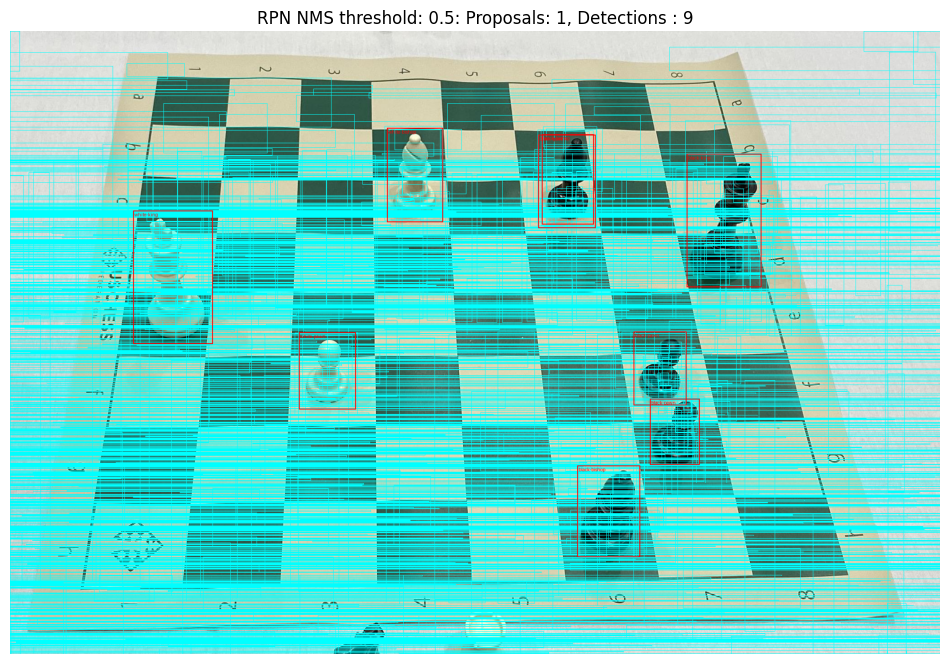

Evaluating with RPN NMS threshold: 0.5
Test:  [ 0/58]  eta: 0:00:18  model_time: 0.0245 (0.0245)  evaluator_time: 0.0035 (0.0035)  time: 0.3236  data: 0.2913  max mem: 1610
Test:  [57/58]  eta: 0:00:00  model_time: 0.0202 (0.0206)  evaluator_time: 0.0010 (0.0022)  time: 0.0328  data: 0.0052  max mem: 1610
Test: Total time: 0:00:02 (0.0445 s / it)
Averaged stats: model_time: 0.0202 (0.0206)  evaluator_time: 0.0010 (0.0022)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.212
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.291
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.257
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.212
 Average Recall     (AR)

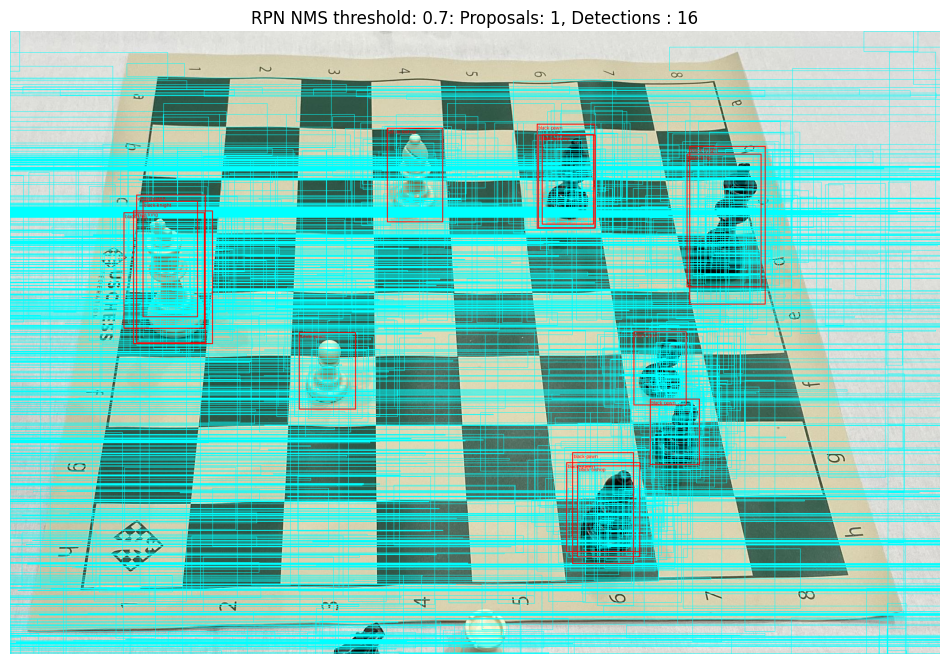

Evaluating with RPN NMS threshold: 0.7
Test:  [ 0/58]  eta: 0:00:18  model_time: 0.0246 (0.0246)  evaluator_time: 0.0040 (0.0040)  time: 0.3179  data: 0.2847  max mem: 1610
Test:  [57/58]  eta: 0:00:00  model_time: 0.0203 (0.0206)  evaluator_time: 0.0012 (0.0023)  time: 0.0331  data: 0.0051  max mem: 1610
Test: Total time: 0:00:02 (0.0414 s / it)
Averaged stats: model_time: 0.0203 (0.0206)  evaluator_time: 0.0012 (0.0023)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.246
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.246
 Average Recall     (AR)

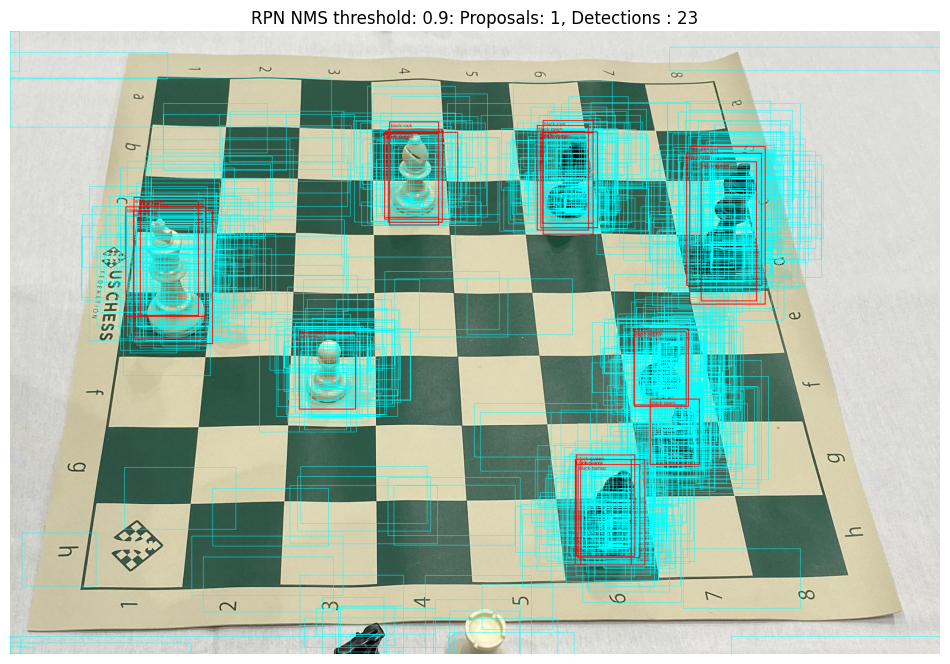

Evaluating with RPN NMS threshold: 0.9
Test:  [ 0/58]  eta: 0:00:18  model_time: 0.0249 (0.0249)  evaluator_time: 0.0041 (0.0041)  time: 0.3234  data: 0.2903  max mem: 1610
Test:  [57/58]  eta: 0:00:00  model_time: 0.0205 (0.0208)  evaluator_time: 0.0013 (0.0023)  time: 0.0335  data: 0.0052  max mem: 1610
Test: Total time: 0:00:02 (0.0418 s / it)
Averaged stats: model_time: 0.0205 (0.0208)  evaluator_time: 0.0013 (0.0023)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.287
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.383
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.362
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.287
 Average Recall     (AR)

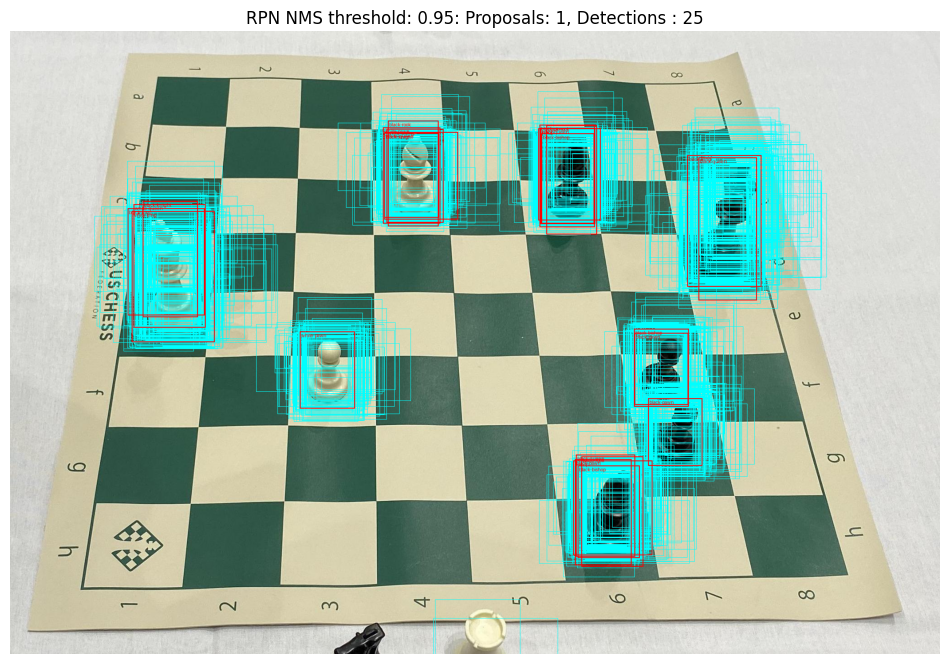

Evaluating with RPN NMS threshold: 0.95
Test:  [ 0/58]  eta: 0:00:18  model_time: 0.0245 (0.0245)  evaluator_time: 0.0041 (0.0041)  time: 0.3188  data: 0.2860  max mem: 1610
Test:  [57/58]  eta: 0:00:00  model_time: 0.0205 (0.0208)  evaluator_time: 0.0011 (0.0023)  time: 0.0340  data: 0.0058  max mem: 1610
Test: Total time: 0:00:02 (0.0417 s / it)
Averaged stats: model_time: 0.0205 (0.0208)  evaluator_time: 0.0011 (0.0023)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.230
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.289
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.230
 Average Recall     (AR

In [92]:

original_nms_thresh = model.rpn.nms_thresh

nms_thresholds = [0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 0.95]

for nms_thresh in nms_thresholds:

    img = read_image(img_paths[1])
    batch = [preprocess(img).to(DEVICE)]

    with torch.no_grad():
        start_time = time.time()
        proposals, predictions = extract_proposals_and_predictions(model, batch, DEVICE)
        end_time = time.time()
        inference_time = end_time - start_time
        print(f"Inference time for visualization: {inference_time:.2f} seconds")
        visualize_proposals_and_predictions(batch, proposals, predictions, chess_val, title=f'RPN NMS threshold: {nms_thresh}')


    print(f"Evaluating with RPN NMS threshold: {nms_thresh}")
    inference_time = evaluate_with_rpn_nms_threshold(model, val_loader, DEVICE, nms_thresh)
    print(f"Inference time: {inference_time:.2f} seconds")



model.rpn.nms_thresh = original_nms_thresh